In [1]:
%matplotlib inline
import pandas as pd
import numpy as np
from mpl_toolkits import mplot3d
import matplotlib.pyplot as plt
import networkx as nx

In [2]:
data_1 = pd.read_excel('Data_1.xlsx')
data_2 = pd.read_excel('Data_2.xlsx')

d:\Anaconda\envs\pytorch\lib\site-packages\openpyxl\worksheet\_reader.py:312: UserWarning: Unknown extension is not supported and will be removed
  warn(msg)


In [3]:
data_1

,编号,X坐标（单位: m）,Y坐标（单位:m）,Z坐标（单位: m）,前后距离,Type,Q_3
0,0,0.000000,50000.000000,5000.000000,NaN,A 点,0
1,1,33070.825831,2789.480761,5163.524680,NaN,0,0
2,2,54832.887019,49179.219108,1448.303791,NaN,1,1
3,3,77991.545911,63982.175286,5945.823038,NaN,0,0
4,4,16937.179535,84714.341903,5360.293002,NaN,0,0
...,...,...,...,...,...,...,...
608,608,45789.201490,21191.207906,440.001872,NaN,1,0
609,609,94917.734859,82958.725321,6169.657707,NaN,0,0
610,610,14870.601682,95939.173362,8248.836185,NaN,0,0
611,611,93009.567446,4549.333260,7882.608297,NaN,1,0


In [4]:
print('data_1 shape: ', data_1.shape)
print('data_2 shape: ', data_2.shape)

data_1_len = len(data_1)
data_2_len = len(data_1)
print(data_1_len)

data_1 shape:  (613, 7)
data_2 shape:  (327, 8)
613


In [5]:
# 垂直校准（垂直最大误差， 水平最大误差），水平校准（垂直最大误差， 水平最大误差），按规划前行最小误差，单位误差
data_1_param = [25, 15, 25, 20, 30, 0.001]
data_2_param = [20, 10, 15, 20, 20, 0.001]

In [6]:
data_1_A_x = data_1.iloc[0,1]
data_1_A_y = data_1.iloc[0,2]
data_1_A_z = data_1.iloc[0,3]

data_1_B_x = data_1.iloc[data_1_len - 1, 1]
data_1_B_y = data_1.iloc[data_1_len - 1, 2]
data_1_B_z = data_1.iloc[data_1_len - 1, 3]

In [31]:
data_1_start_end_x = [data_1_A_x, data_1_B_x]
data_1_start_end_y = [data_1_A_y, data_1_B_y]
data_1_start_end_z = [data_1_A_z, data_1_B_z]

data_1_point_x = data_1.iloc[ :, 1].to_list()
data_1_point_y = data_1.iloc[ :, 2].to_list()
data_1_point_z = data_1.iloc[ :, 3].to_list()
# data_1 vec(1) hor(0)
data_1_vec_hor = data_1.groupby(by='Type')
data_1_hor = data_1_vec_hor.get_group(0)
data_1_vec = data_1_vec_hor.get_group(1)

data_1_vec_x = data_1_vec.iloc[ :, 1].to_list()
data_1_vec_y = data_1_vec.iloc[ :, 2].to_list()
data_1_vec_z = data_1_vec.iloc[ :, 3].to_list()
data_1_vec_index = data_1_vec.iloc[:, 0].to_list()

data_1_hor_x = data_1_hor.iloc[ :, 1].to_list()
data_1_hor_y = data_1_hor.iloc[ :, 2].to_list()
data_1_hor_z = data_1_hor.iloc[ :, 3].to_list()
data_1_hor_index = data_1_hor.iloc[:, 0].to_list()


In [24]:
data_1_vec

,编号,X坐标（单位: m）,Y坐标（单位:m）,Z坐标（单位: m）,前后距离,Type,Q_3
2,2,54832.887019,49179.219108,1448.303791,NaN,1,1
5,5,339.689398,14264.462882,3857.846358,NaN,1,0
6,6,3941.930556,74279.863632,9702.921007,NaN,1,1
7,7,45474.013645,26849.482134,6411.716766,NaN,1,0
10,10,35987.312414,2169.077624,2390.301133,NaN,1,0
...,...,...,...,...,...,...,...
600,600,11142.642439,27456.822918,3734.448203,NaN,1,1
603,603,34066.545819,71469.909041,9008.156443,NaN,1,0
605,605,72757.603845,97745.637293,2797.394034,NaN,1,0
608,608,45789.201490,21191.207906,440.001872,NaN,1,0


In [17]:
a_b_string = ['A', 'B']

In [19]:
print(len(data_1_point_x))
print(len(data_1_point_y))
print(len(data_1_point_z))
print(data_1_B_z)
print(data_1_point_z[0])

613
613
613
5022.00116448164
5000.0


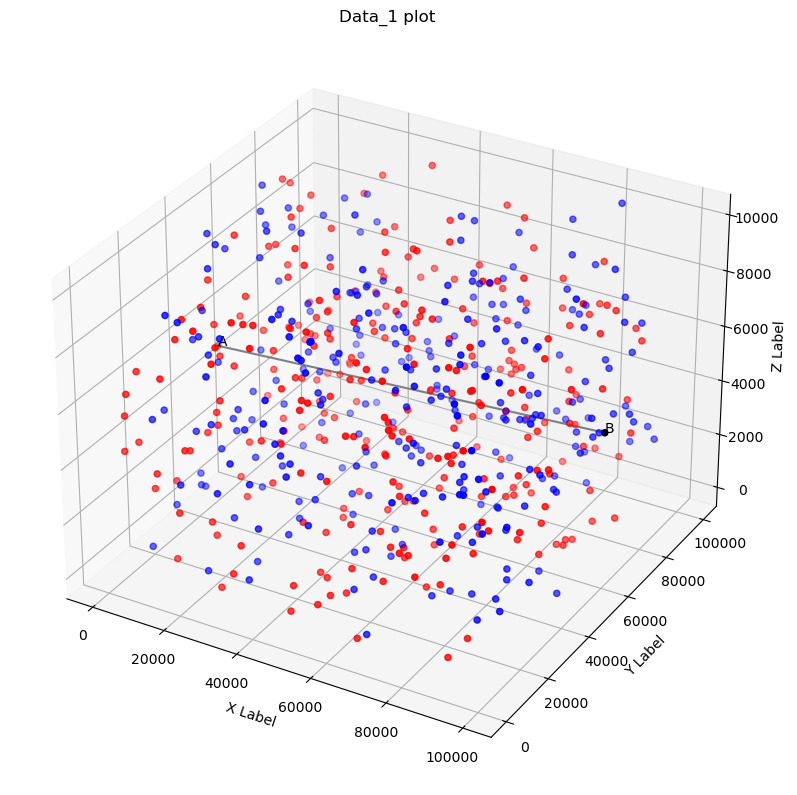

In [25]:
fig = plt.figure(figsize=(10, 10), dpi =100)
# 创建3d绘图区域
ax = fig.add_subplot(projection='3d')
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

ax.scatter3D(data_1_start_end_x, data_1_start_end_y, data_1_start_end_z, c = 'black')
ax.scatter3D(data_1_vec_x, data_1_vec_y, data_1_vec_z, c = 'red')
ax.scatter3D(data_1_hor_x, data_1_hor_y, data_1_hor_z, c = 'blue')

for i in range(0, len(a_b_string)):
    ax.text(data_1_start_end_x[i], data_1_start_end_y[i], data_1_start_end_z[i], a_b_string[i])
ax.set_title('Data_1 plot')
ax.plot3D(data_1_start_end_x, data_1_start_end_y, data_1_start_end_z, 'gray' )
plt.show()

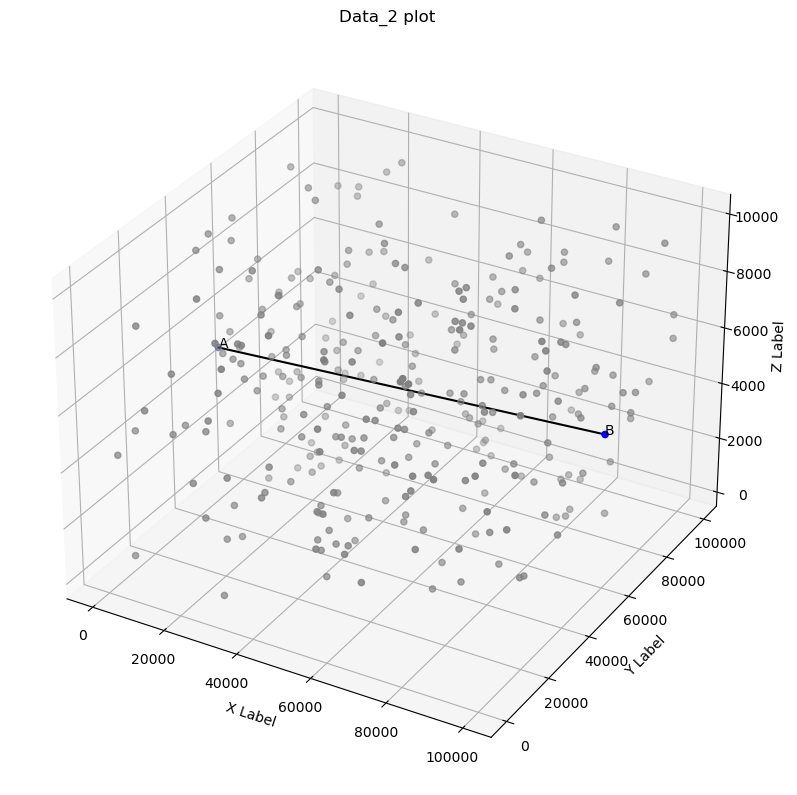

In [30]:
# fig = plt.figure(figsize=(10, 10), dpi =100)
# # 创建3d绘图区域
# ax = fig.add_subplot(projection='3d')
# ax.set_xlabel('X Label')
# ax.set_ylabel('Y Label')
# ax.set_zlabel('Z Label')

# ax.scatter3D(data_2_start_end_x, data_2_start_end_y, data_2_start_end_z, c = 'blue')
# ax.scatter3D(data_2_point_x, data_2_point_y, data_2_point_z, c = 'gray')

# for i in range(0, len(a_b_string)):
#     ax.text(data_2_start_end_x[i], data_2_start_end_y[i], data_2_start_end_z[i], a_b_string[i])
# ax.set_title('Data_2 plot')
# ax.plot3D(data_2_start_end_x, data_2_start_end_y, data_2_start_end_z, 'black' )
# plt.show()

In [26]:
# 距离计算公式
from math import sqrt

def point_point_distance(x_1, y_1, z_1, x_2, y_2, z_2):
    p_p_distance = sqrt((x_1 - x_2) ** 2 + (y_1 - y_2) ** 2 + (z_1 - z_2) ** 2)
    return p_p_distance
    

In [27]:
def data_distance(index_0, index_1):
    temp_distance = np.Inf
    temp_distance = point_point_distance(data_1_point_x[index_0], data_1_point_y[index_0], data_1_point_z[index_0], 
                                            data_1_point_x[index_1], data_1_point_y[index_1], data_1_point_z[index_1])
    return temp_distance
        

In [28]:
data_1_mat = np.zeros((data_1_len, data_1_len))
data_1_graph = np.zeros((data_1_len, data_1_len))

data_inf = np.Inf

In [37]:
from ctypes import sizeof


print(data_distance(0, 1))
print(data_1_param[-1])
print(data_1_param[-2])
# print(data_1_hor_index)
# print(2 in data_1_hor_index)


57641.47281500988
0.001
30


In [53]:
# data_1_vec_hor.size()
range(1, data_1_len)
print(data_1_point_x[data_1_len - 1])

100000.0


In [54]:
# 上三角矩阵
for i in range(0, data_1_len):
    for j in range(i, data_1_len):
        if i == j :
            data_1_mat[i][j] = data_inf
            data_1_graph[i][j] = 0
        # 同属于一个校正组
        elif i in data_1_hor_index and j in data_1_hor_index:
            data_1_mat[i][j] = data_inf
            data_1_graph[i][j] = 0
        elif i in data_1_vec_index and j in data_1_vec_index:
            data_1_mat[i][j] = data_inf
            data_1_graph[i][j] = 0
        else:
            dist = data_distance(i, j)
            # 如果为终端点小于30
            if j == data_1_len - 1 and dist * data_1_param[-1] >= data_1_param[-2]:
                    data_1_mat[i][j] = data_inf
                    data_1_graph[i][j] = 0
            # j 为垂直校正点
            elif j in data_1_vec_index:
                if dist * data_1_param[-1] >= data_1_param[0] or dist * data_1_param[-1] >= data_1_param[1]:
                    data_1_mat[i][j] = data_inf
                    data_1_graph[i][j] = 0
            # j 为水平校正点
            elif j in data_1_hor_index:
                if dist * data_1_param[-1] >= data_1_param[3] or dist * data_1_param[-1] >= data_1_param[2]:
                    data_1_mat[i][j] = data_inf
                    data_1_graph[i][j] = 0
            else:
                data_1_mat[i][j] = dist
                data_1_graph[i][j] = dist
print(data_1_graph)

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


In [56]:
data_1_i, data_1_j = np.nonzero(data_1_graph)  #提取顶点的编号
data_1_w = data_1_graph[data_1_i, data_1_j]  #提出a中的非零元素
data_1_edges = list(zip(data_1_i, data_1_j, data_1_w))

In [57]:
data_1_G = nx.Graph()
data_1_G.add_weighted_edges_from(data_1_edges)
dat_1_key = range(data_1_len)
data_1_s = [str(i+1) for i in range(data_1_len)]
data_1_s = dict(zip(dat_1_key,data_1_s))  #构造用于顶点标注的字符字典

In [59]:
plt.rc('font',size=18)
fig = plt.figure(figsize=(50, 50), dpi =500)
plt.subplot(121)
pos = nx.random_layout(data_1_G)
nx.draw_networkx(data_1_G, pos=pos, font_weight='bold', node_size = 250,labels=data_1_s)
# plt.subplot(122)
# pos=nx.shell_layout(data_1_G)  #布局设置
# nx.draw_networkx(data_1_G,pos,node_size=260,labels=s)
# w = nx.get_edge_attributes(data_1_G,'weight')
# nx.draw_networkx_edge_labels(data_1_G,pos,font_size=12,edge_labels=w) #标注权重
plt.show()

In [60]:
def dijkstra(matrix, start_point):
    matrix_len = len(matrix)
    path_array = [] # 用于保存路径
    temp_array = [] # 用于复制
    path_array.extend(matrix[start_point])
    temp_array.extend(matrix[start_point])
    
    temp_array[start_point] = data_inf # 处理过得节点变成inf, 表示不是最小权值的节点
    visited = [start_point] # 用于保存处理过得节点
    path_parent = [start_point] * matrix_len # 初始父节点都为start_point
    
    while len(visited) < matrix_len:
        i = temp_array.index(min(temp_array)) # 从最近开始寻找
        temp_array[i] = data_inf # 已处理变为inf
        path = [str(i)] # 用于画路径
        k = i 
        while path_parent[k] != start_point: # 找该节点的父节点添加到path，直到父节点是start
            path.append(str(path_parent[k]))
            k = path_parent[k]
        path.append(str(start_point))
        path.reverse() # path反序产生路径
        print(str(i) + ':', '->'.join(path))
        visited.append(i) # 该索引已经处理了
        for j in range(matrix_len):
            if j not in visited:
                if path_array[i] + matrix[i][j] < path_array[j]:
                    path_array[j] = matrix[i][j] = path_array[i] + matrix[i][j]
                    path_parent[j] = i  # 说明父节点是i
    return path_array    

In [66]:
# 先构建约束网络，求出所有通路，再通过优化算法去逼近最优值
# 两个数组存储在该节点的累计误差
data_1_vec_buff = np.zeros((data_1_len, data_1_len))
data_1_hor_buff = np.zeros((data_1_len, data_1_len))

for i in range(1, data_1_len):
    for j in range(1, data_1_len):
        data_1_vec_buff[i][j] = data_inf
        data_1_hor_buff[i][j] = data_inf

# 先求装置再相加
data_1_mat_T = data_1_mat.T
data_1_mat = data_1_mat + data_1_mat_T

In [69]:
int(False)

0

In [ ]:
# 路径数组
from importlib.resources import path


data_1_path_array = []
# 转存数组
data_1_temp_array = []

data_1_path_array.extend(data_1_mat[0])
data_1_temp_array.extend(data_1_mat[0])

data_1_temp_array[0] = data_inf

# 父节点数组
data_1_path_parent = [0] * data_1_len
# 已处理数组
data_1_visited = [0]
while len(data_1_visited) < data_1_len:
    index_i = data_1_temp_array.index(min(data_1_temp_array))
    # 因为自身点已经设为inf，所以不可能是A点
    flag_vec_or_hor = int(index_i in data_1_vec_index)
    data_1_temp_array[index_i] = data_inf
    index_k = index_i
    while data_1  

